Colors and RGBA Values

In [1]:
from PIL import ImageColor
ImageColor.getcolor('red', 'RGBA')

(255, 0, 0, 255)

In [2]:
ImageColor.getcolor('RED', 'RGBA')

(255, 0, 0, 255)

In [3]:
ImageColor.getcolor('Black', 'RGBA')

(0, 0, 0, 255)

In [4]:
ImageColor.getcolor('chocolate', 'RGBA')

(210, 105, 30, 255)

In [5]:
ImageColor.getcolor('CornflowerBlue', 'RGBA')

(100, 149, 237, 255)

Manipulating Images with Pillow

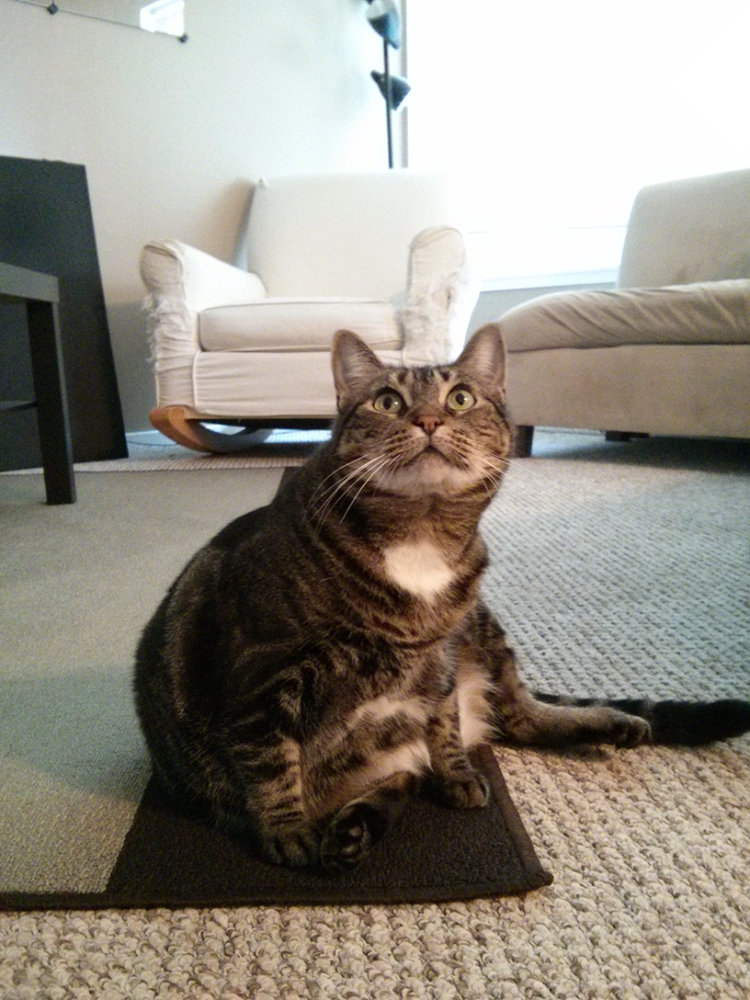

In [8]:
from PIL import Image
catIm = Image.open('zophie.png')
catIm

Working with the Image Data Type

In [9]:
catIm.size

(816, 1088)

In [11]:
width, height = catIm.size

print("width: ", width)
print("height: ", height)

width:  816
height:  1088


In [13]:
catIm.format

'PNG'

In [14]:
catIm.format_description

'Portable network graphics'

In [15]:
catIm.save('zophie.jpg')

In [16]:
im = Image.new('RGBA', (100, 200), 'purple')
im.save('purpleImage.png')

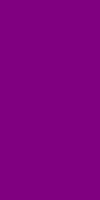

In [27]:
im

In [17]:
im2 = Image.new('RGBA', (20, 20))
im2.save('transparentImage.png')

In [26]:
im2

Cropping Images

In [18]:
croppedIm = catIm.crop((335, 345, 565, 560))
croppedIm.save('cropped.png')

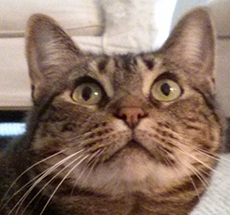

In [24]:
croppedIm

Copying and Pasting Images onto Other Images

In [19]:
catCopyIm = catIm.copy()

In [20]:
faceIm = catIm.crop((335, 345, 565, 560))
faceIm.size

(230, 215)

In [21]:
catCopyIm.paste(faceIm, (0, 0))
catCopyIm.paste(faceIm, (400, 500))
catCopyIm.save('pasted.png')

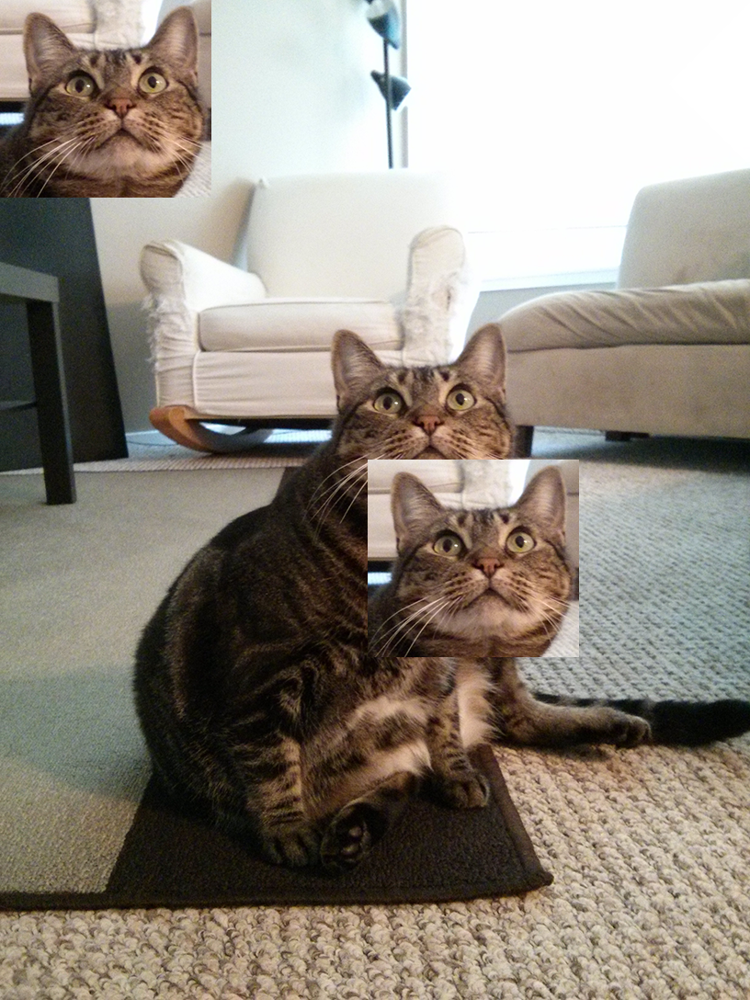

In [25]:
catCopyIm

In [22]:
catImWidth, catImHeight = catIm.size
faceImWidth, faceImHeight = faceIm.size
catCopyTwo = catIm.copy()
for left in range(0, catImWidth, faceImWidth):
    for top in range(0, catImHeight, faceImHeight):
        print(left, top)
        catCopyTwo.paste(faceIm, (left, top))
catCopyTwo.save('tiled.png')

0 0
0 215
0 430
0 645
0 860
0 1075
230 0
230 215
230 430
230 645
230 860
230 1075
460 0
460 215
460 430
460 645
460 860
460 1075
690 0
690 215
690 430
690 645
690 860
690 1075


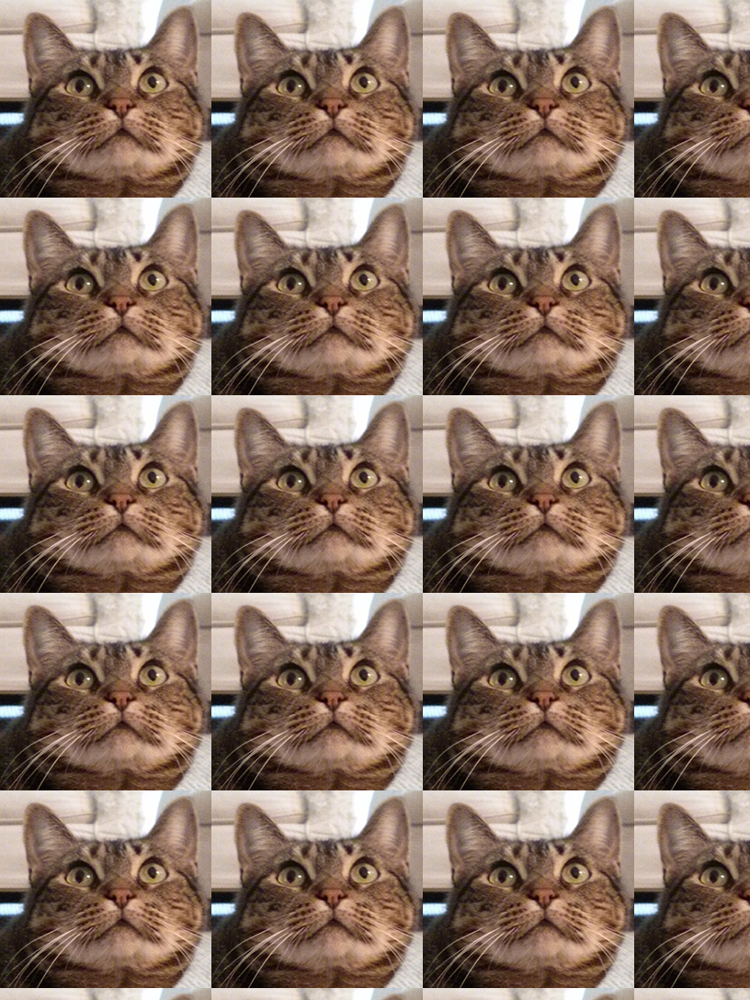

In [23]:
catCopyTwo

Resizing Images

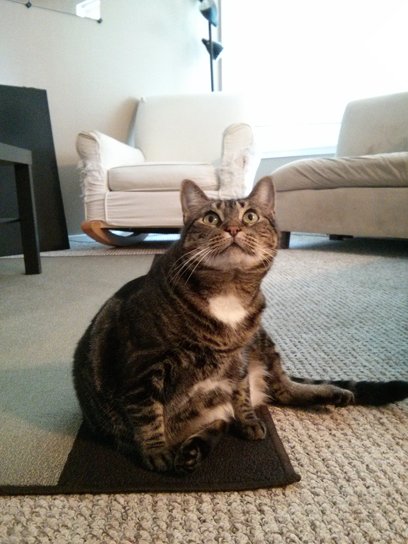

In [28]:
catIm = Image.open('zophie.png')
width, height = catIm.size
quartersizedIm = catIm.resize((int(width / 2), int(height / 2)))
quartersizedIm.save('quartersized.png')

quartersizedIm

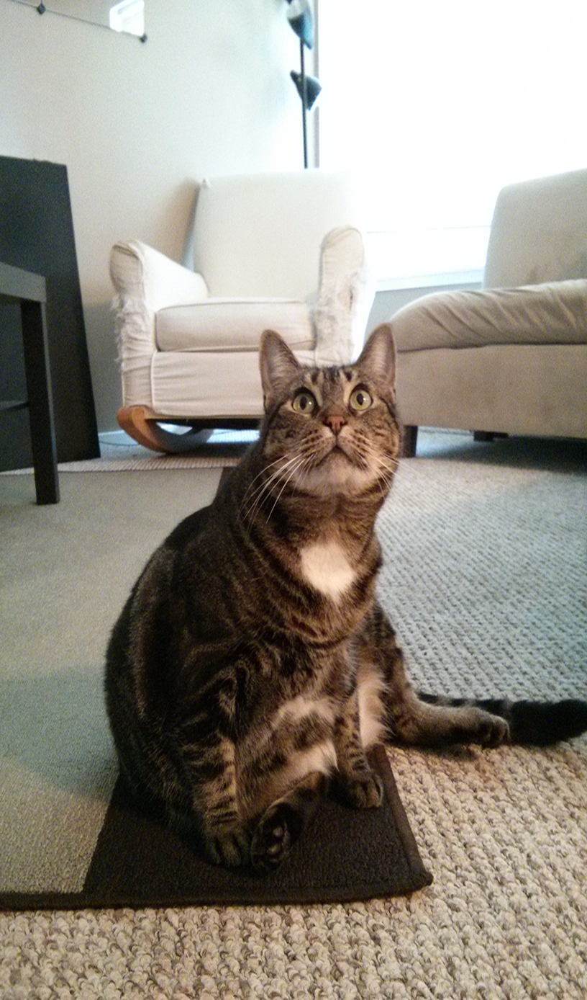

In [29]:
svelteIm = catIm.resize((width, height + 300))
svelteIm.save('svelte.png')

svelteIm

Rotating and Flipping Images

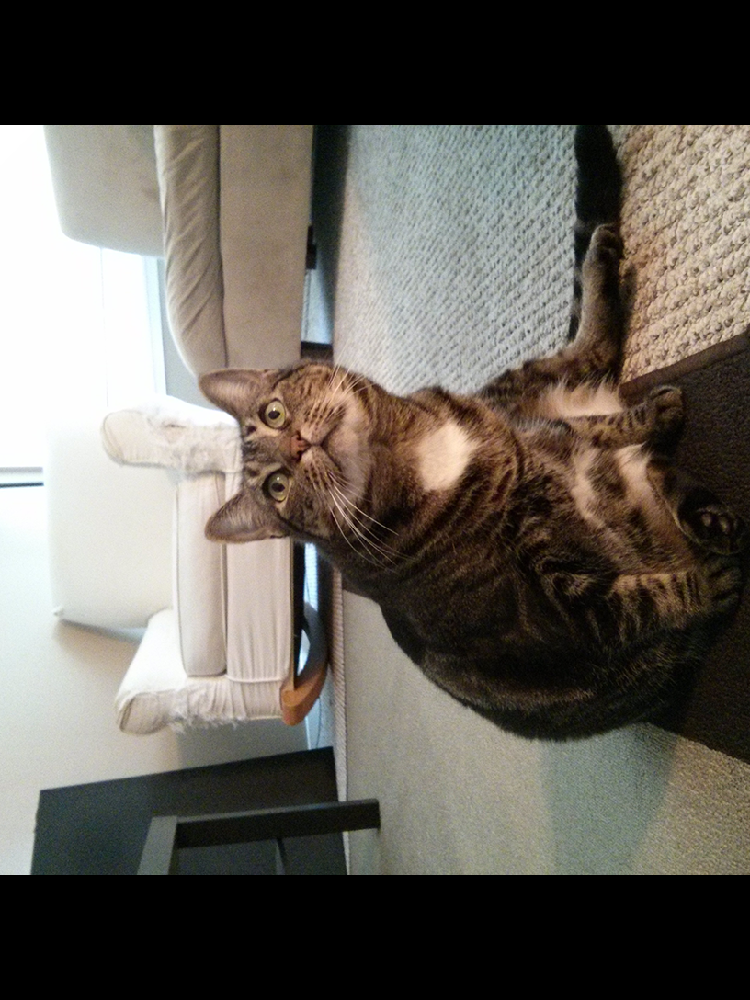

In [30]:
rotated90 = catIm.rotate(90)
rotated90.save('rotated90.png')

rotated90

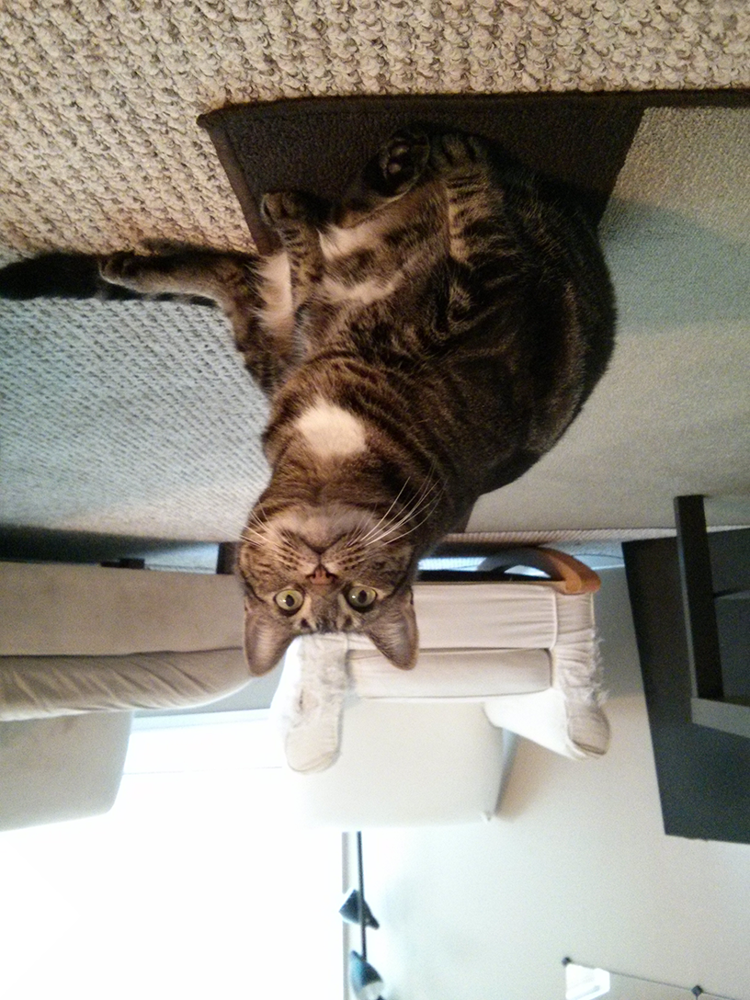

In [31]:
rotated180 = catIm.rotate(180)
rotated180.save('rotated180.png')

rotated180

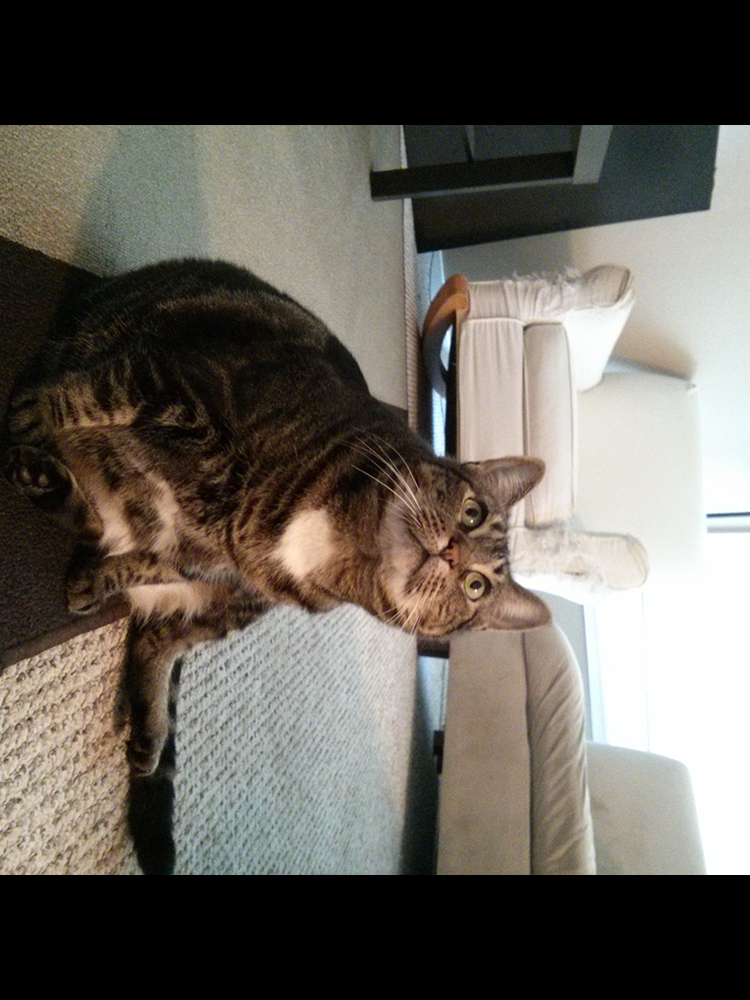

In [32]:
rotated270 = catIm.rotate(270)
rotated270.save('rotated270.png')

rotated270

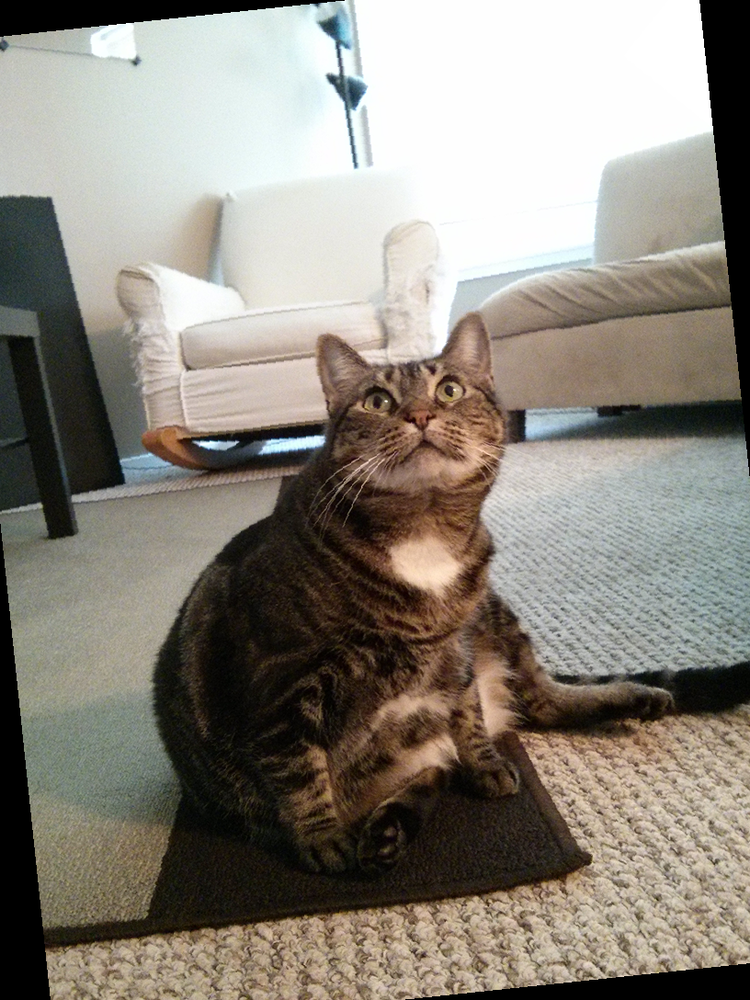

In [33]:
rotated6 = catIm.rotate(6)
rotated6.save('rotated6.png')

rotated6

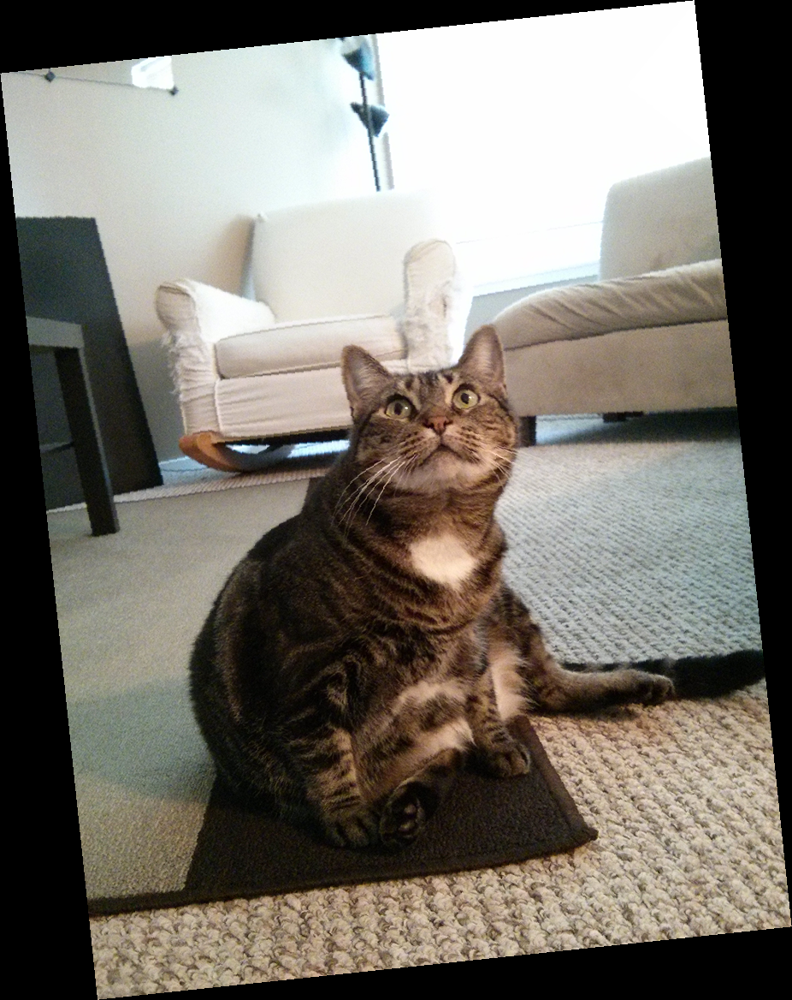

In [34]:
rotated6_expanded = catIm.rotate(6, expand=True)
rotated6_expanded.save('rotated6_expanded.png')

rotated6_expanded

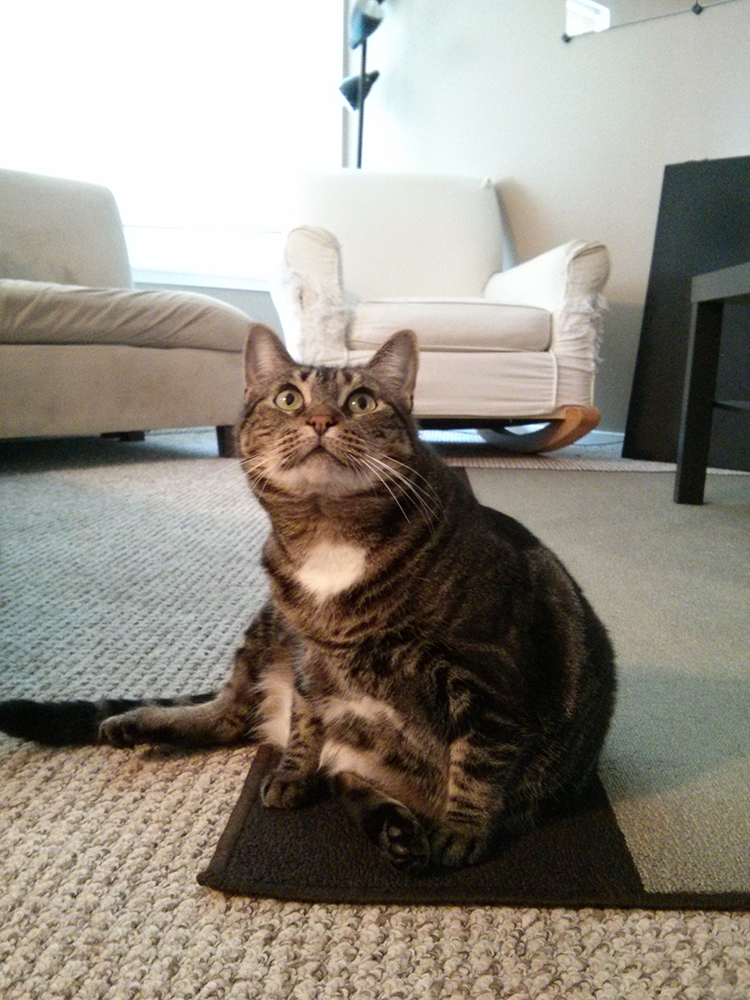

In [35]:
horizontal_flip = catIm.transpose(Image.FLIP_LEFT_RIGHT)
horizontal_flip.save('horizontal_flip.png')

horizontal_flip

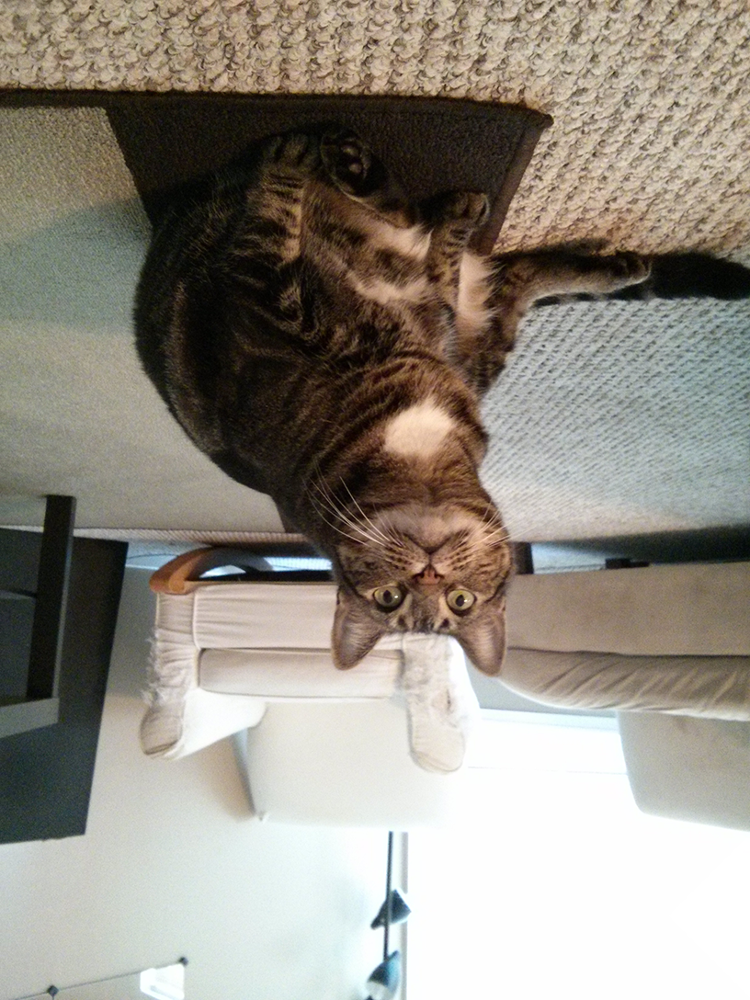

In [36]:
vertical_flip = catIm.transpose(Image.FLIP_TOP_BOTTOM)
vertical_flip.save('vertical_flip.png')

vertical_flip

Changing Individual Pixels

In [37]:
im = Image.new('RGBA', (100, 100))
im.getpixel((0, 0))

(0, 0, 0, 0)

In [38]:
for x in range(100):
    for y in range(50):
        im.putpixel((x, y), (210, 210, 210))

In [39]:
for x in range(100):
    for y in range(50, 100):
        im.putpixel((x, y), ImageColor.getcolor('darkgray', 'RGBA'))

In [40]:
im.getpixel((0, 0))

(210, 210, 210, 255)

In [42]:
im.getpixel((0, 50))

(169, 169, 169, 255)

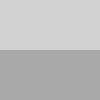

In [43]:
im.save('putPixel.png')

im

Drawing Shapes

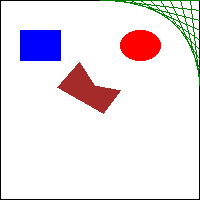

In [44]:
from PIL import ImageDraw

im = Image.new('RGBA', (200, 200), 'white')
draw = ImageDraw.Draw(im)
draw.line([(0, 0), (199, 0), (199, 199), (0, 199), (0, 0)], fill='black')
draw.rectangle((20, 30, 60, 60), fill='blue')
draw.ellipse((120, 30, 160, 60), fill='red')
draw.polygon(((57, 87), (79, 62), (94, 85), (120, 90), (103, 113)), fill='brown')

for i in range(100, 200, 10):
    draw.line([(i, 0), (200, i - 100)], fill='green')
    
im.save('drawing.png')

im

Drawing Text

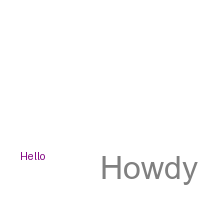

In [45]:
from PIL import ImageFont
import os

im = Image.new('RGBA', (200, 200), 'white')
draw = ImageDraw.Draw(im)
draw.text((20, 150), 'Hello', fill='purple')
fontsFolder = 'FONT_FOLDER' # e.g. 'Library/Fonts'
arialFont = ImageFont.truetype(os.path.join(fontsFolder, 'arial.ttf'), 32)
draw.text((100, 150), 'Howdy', fill='gray', font=arialFont)
im.save('text.png')

im